# Explainable Neural Networks

**Name**: Enrico Grimaldi

**Matricola**: 1884443


## Instructions to run the notebook

Follow the steps in the given order:

1. create a Kaggle API token on your Kaggle account and download it (it will be automatically downloaded as `kaggle.json`);
2. Enter [google drive](https://drive.google.com/) and create inside the `my drive` directory the following folders:
>- `my kaggle` folder and put inside it your kaggle token `kaggle.json`
>- `NNDS_hw1` folder and put inside it the script `load.py` from [this github repository](https://github.com/Engrima18/ExaplainNET)
3. Start running the following cells and accept the google drive access permission request from the current notebook.

Enjoy Explainable AI.

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, losses
from tensorflow.keras.callbacks import History
from collections import defaultdict
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os
import shutil
from PIL import Image
from typing import Tuple, Dict, List, Union

In [ ]:
# To ensure reproducible results (as much as possible)
tf.keras.utils.set_random_seed(1234)

### Overview

Neural networks are powerful tools, but they are **black-boxes**, meaning that it is difficult to provide human-understandable explanations on what they are doing. The field of **explanaibility** is concerned with finding algorithms for achieving this. I will implement explanaibility algorithms (**saliency maps**, **smooth grads** and **integrated grads**) replicating the main achievements gained in the reported resources, simply playing with the TensorFlow autodiff framework.

## Data loading



The data set taken from Kaggle consists of color (RGB) microscope [images of pollen grains](https://www.kaggle.com/datasets/andrewmvd/pollen-grain-image-classification), specifically divided into 23 classes and the main task of the neural network will then consist of correctly classifying these images.

Data have been previously processed and organized via ad hoc script (load_data.py, loaded from a folder in google dirve called "NNDS_hw1") which redirects the single image to the correct directory looking at its name. I chose this data set for two reasons:

1. I am very interested in the application in mycrobiology of deep learning models
2. I would like to try to go over the proposed papers pari passu, through image printing of saliency maps and their different versions

In [ ]:
# TODO: Insert any data loading code here. If the data loading part is complex,
# consider using a separate .py file that you can attach to the submission.

dataset_author = "andrewmvd"
dataset_name = "pollen-grain-image-classification"
dataset_path = dataset_author + "/" + dataset_name

# Mount your Google Drive.
from google.colab import drive
drive.mount("/content/drive")

kaggle_creds_path = "/content/drive/MyDrive/my_kaggle/kaggle.json"

# remove kaggle directory if already exists, then crate it
!pwd
!rm -r ~/.kaggle
! mkdir ~/.kaggle
! cp {kaggle_creds_path} ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

! pip install kaggle --quiet
! kaggle datasets download -d {dataset_path}

import zipfile
zip_ref = zipfile.ZipFile(f'{dataset_name}.zip', 'r')

! mkdir dataset
zip_ref.extractall('/content/dataset')
zip_ref.close()

my_script_path = "/content/drive/MyDrive/NNDS_hw1/load_data.py"
! cp {my_script_path} /content/
! python3 load_data.py

# Unmount your Google Drive
drive.flush_and_unmount()

Mounted at /content/drive
/content
rm: cannot remove '/root/.kaggle': No such file or directory
 50% 12.0M/24.1M [00:00<00:00, 44.8MB/s]
100% 24.1M/24.1M [00:00<00:00, 67.5MB/s]
Dataset correctly loaded and organized!


In [ ]:
def visualize_samples(data_path: str) -> Tuple[int, Dict[int, str]]:
    """
    Visualizes sample images (one for each class) from a directory and displays class labels.

    Parameters:
    - data_path (str): The path to the directory containing class subdirectories with images.

    Returns:
    - Tuple[int, Dict[int, str]]: A tuple containing the total number of classes and a dictionary
      mapping numerical labels to class names.
    """
    labels = []
    num_classes = len(os.listdir(data_path))

    fig, ax = plt.subplots(4, 6, figsize=(15, 10))
    fig.subplots_adjust(hspace=0.2, wspace=0.2)

    for i, label_directory in enumerate(os.listdir(data_path)):
        label_path = os.path.join(data_path, label_directory)

        if os.path.isdir(label_path):
            sample_image = os.listdir(label_path)[0]
            image_path = os.path.join(label_path, sample_image)
            img = Image.open(image_path)

            ax[i // 6, i % 6].set_xticks([])
            ax[i // 6, i % 6].set_yticks([])
            ax[i // 6, i % 6].set_title(label_directory)
            ax[i // 6, i % 6].imshow(img)

        labels.append(label_directory)

    fig.delaxes(ax[3, 5])
    fig.suptitle(f'Total number of classes: {num_classes}', fontsize=13)
    plt.show()

    labels_dict = {i: lab for i, lab in enumerate(sorted(labels))}
    return num_classes, labels_dict


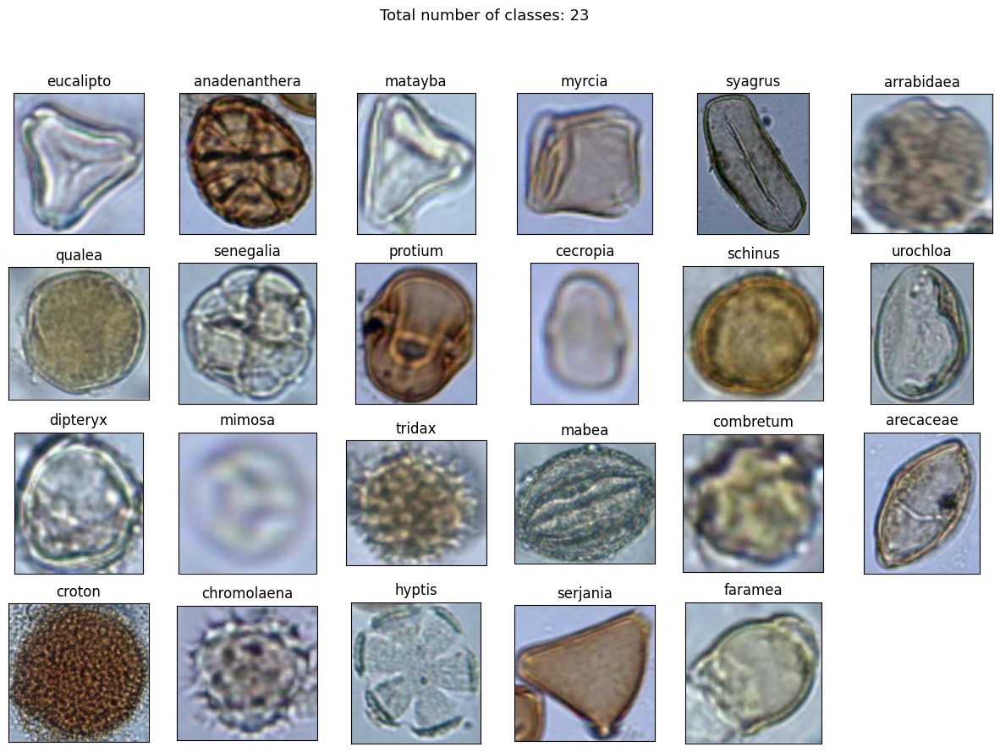


Found 790 files belonging to 23 classes.
Using 632 files for training.
Found 790 files belonging to 23 classes.
Using 158 files for validation.


In [ ]:
# organize and visualize the data
SOURCE_PATH = os.getcwd()
DATA_PATH = os.path.join(SOURCE_PATH, "dataset")
num_classes, labels = visualize_samples(DATA_PATH)
print()
# divide data in train and validation set
BATCH_SIZE = 16
IMG_HEIGHT = 180
IMG_WIDTH = 180

train = tf.keras.utils.image_dataset_from_directory(
  DATA_PATH,
  validation_split=0.2,
  subset="training",
  seed=1234,
  image_size=(IMG_HEIGHT, IMG_WIDTH),
  batch_size=BATCH_SIZE)

val = tf.keras.utils.image_dataset_from_directory(
  DATA_PATH,
  validation_split=0.2,
  subset="validation",
  seed=1234,
  image_size=(IMG_HEIGHT, IMG_WIDTH),
  batch_size=BATCH_SIZE)

# optimize the I/O memory reading for performances during training
AUTOTUNE = tf.data.AUTOTUNE
train = train.cache().prefetch(buffer_size=AUTOTUNE)
val = val.cache().prefetch(buffer_size=AUTOTUNE)

## Train a neural network model

#### Defining the network model

I considered using a CNN with not too many layers so as not to make the model much heavy.

Moreover, I preferred the use of a gelu instead of relu because the former does not have the point of non-differentiability at 0 (so as to avert any problems due to sub-differentiability as in the case of **Deconv NN** in the paper [1]).

Finally, I used a `layers.Dense` layer without any activation function, instead of a softmax layer, in order to output the logits instead of the values already normalized by the softmax. The logits will then be useful in the calculation of the Saliency map since in the paper [1] it is explicitly recommended to derive the logits (un-normalized value and thus uniquely related to the class of interest) w.r.t. the inputs.

In [ ]:
# TODO: define a suitable neural network.
# Define augmentation block
data_augmentation = tf.keras.Sequential([
  layers.experimental.preprocessing.RandomFlip('horizontal'),
  layers.experimental.preprocessing.RandomFlip('vertical'),
  layers.experimental.preprocessing.RandomRotation(0.2),
  layers.experimental.preprocessing.RandomZoom(0.2),
])

# Define the CNN model
model = tf.keras.Sequential([
  data_augmentation,
  layers.Rescaling(1./255, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3), offset=-1),
  layers.Conv2D(16, kernel_size=(3,3), activation='gelu', input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)),
  layers.MaxPooling2D(pool_size=2),
  layers.Conv2D(32, kernel_size=(3,3), activation='gelu', input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)),
  layers.MaxPooling2D(pool_size=2),
  layers.Conv2D(64, kernel_size=(3,3), activation='gelu'),
  layers.MaxPooling2D(pool_size=2),
  layers.Conv2D(128, kernel_size=(3,3), activation='gelu'),
  layers.MaxPooling2D(pool_size=2),
  layers.Flatten(),
  layers.Dense(400, activation='gelu'),
  layers.Dropout(rate=0.5),
  layers.Dense(num_classes)
])

Simply check if the GPU is avalable (tf will use it as the default computational tool for the task)

In [ ]:
# Check the GPU availability
tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

Please notice the use of the loss with "from_logits=True" for the correct use of logits instead of softmax output.

In [ ]:
# TODO: train the neural network.

# Hyperparameters selection
EPOCHS = 100
BATCH_SIZE_SGD = 64

# Define the loss - 'from_logits=True' is important since we don't use the softmax at the last layer
loss_func = losses.SparseCategoricalCrossentropy(from_logits=True)

model.compile(optimizer='adam',
              loss=loss_func,
              metrics=['accuracy'])

history = model.fit(train, validation_data=val, epochs=EPOCHS, batch_size=BATCH_SIZE_SGD)

Epoch 1/100
40/40 [==============================] - 22s 91ms/step - loss: 2.8949 - accuracy: 0.1013 - val_loss: 2.5851 - val_accuracy: 0.1519
Epoch 2/100
40/40 [==============================] - 2s 48ms/step - loss: 2.5283 - accuracy: 0.1962 - val_loss: 2.2693 - val_accuracy: 0.2975
Epoch 3/100
40/40 [==============================] - 2s 51ms/step - loss: 2.1867 - accuracy: 0.2848 - val_loss: 1.8693 - val_accuracy: 0.3734
Epoch 4/100
40/40 [==============================] - 2s 43ms/step - loss: 1.9562 - accuracy: 0.3544 - val_loss: 1.6971 - val_accuracy: 0.4684
Epoch 5/100
40/40 [==============================] - 2s 42ms/step - loss: 1.6325 - accuracy: 0.4573 - val_loss: 1.5938 - val_accuracy: 0.5000
Epoch 6/100
40/40 [==============================] - 2s 38ms/step - loss: 1.5495 - accuracy: 0.4778 - val_loss: 1.3937 - val_accuracy: 0.5506
Epoch 7/100
40/40 [==============================] - 1s 35ms/step - loss: 1.2843 - accuracy: 0.5886 - val_loss: 1.2413 - val_accuracy: 0.5949
Epoch

For the performance evaluation of the model, I chose the accuracy score since the task does not require special attention to false positives or false negatives and the classes appear to be well balanced.

The results seem satisfactory even in the absence of an explicit callback for early-stopping: the network performs well in terms of both training and test (validation) accuracy, and the trends of the two losses as a function of epochs do not seem to give any indication of overfitting.

Despite a not exactly convergent trend for the two losses I am satisfied with the obtained results.

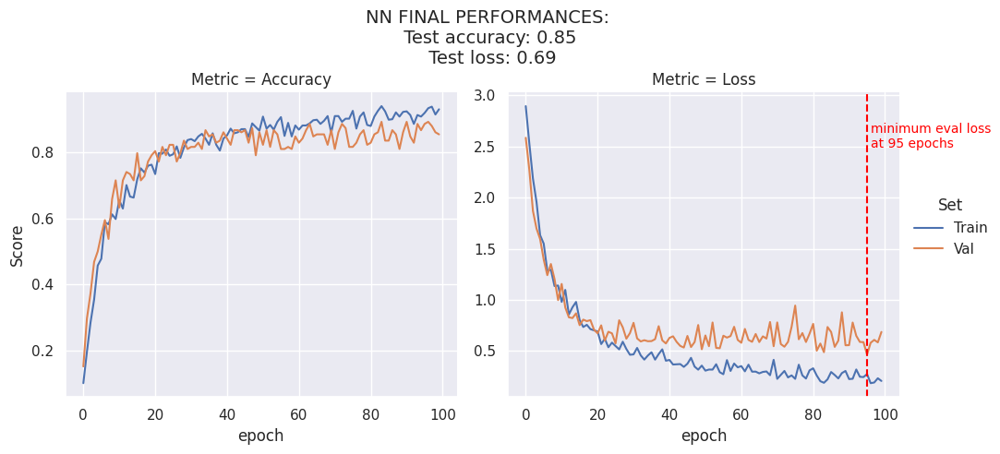

In [ ]:
def plot_performance(history: History) -> Tuple[float, float]:
    """
    Plot the performance metrics of a neural network based on its training history.

    Parameters:
    - history (tf.keras.callbacks.History): The training history of a neural network model.

    Returns:
    - Tuple[float, float]: A tuple containing the test loss and test accuracy of the model.
    """
    loss, acc = model.evaluate(val, verbose=0)

    metrics = pd.DataFrame({
        "train_accuracy": history.history["accuracy"],
        "val_accuracy": history.history["val_accuracy"],
        "val_loss": history.history["val_loss"],
        "train_loss": history.history["loss"],
        "epoch": np.arange(0, 100)
    })

    minimum = metrics[metrics.val_loss == metrics.val_loss.min()].epoch.values[0]
    maximum = metrics.val_loss.max()

    temp = pd.melt(metrics, id_vars=["epoch"],
                   value_vars=['train_accuracy', 'val_accuracy', 'train_loss', 'val_loss'], var_name='Set', value_name='Score')

    temp['Metric'] = temp['Set'].apply(lambda x: x.split('_')[1].capitalize())
    temp['Set'] = temp['Set'].apply(lambda x: x.split('_')[0].capitalize())

    sns.set()
    rel = sns.relplot(temp, x="epoch", y="Score", col="Metric", hue="Set", kind="line", facet_kws={'sharey': False, 'sharex': True})
    rel.fig.suptitle(f'NN FINAL PERFORMANCES: \n Test accuracy: {acc:.2f} \n Test loss: {loss:.2f}', fontsize=14)
    rel.fig.subplots_adjust(top=.8)
    plt.axvline(minimum, color='red', linestyle="--")
    plt.text(minimum+1, maximum-0.1, f'minimum eval loss\nat {minimum} epochs', color="red", fontsize=10)
    plt.show()

    return loss, acc

loss, acc = plot_performance(history)

## Computing a vanilla saliency map

> I will report the techniques highlighted in [1]. This is one of the first papers that tried to apply this kind of techniques to modern neural networks.

What do we mean by explainability? Consider the neural network $f(\cdot)$ you just trained, and a prediction $\hat{y} = f(x)$ we want to analyze. **Feature attribution** methods try to assign a weight $w_i$ to each input feature $x_i$, to understand which parts of the input have contributed the most to the explanation.

The simplest feature attribution technique, called **vanilla saliency map**, simply computes the gradient at that point:

$$
  S(x) = \left\lvert \frac{\partial f_c(x)}{\partial x} \right\rvert
$$

where  $c$ is the index corresponding to the predicted class.

Few important acknowledgements to well understand the reported functions.

#### _Saliency map_

The following is the pipeline proposed in `compute_saliency()`:

1. Given an image $I$ we take the scoring function of the selected class $c$, $S_c(I)$;
2. Note that, as explained in step 2 of resource [1], we do not take the softmax output $P_c = \frac{(exp(S_c)}{\sum_c exp(S_c)}$ but only the unnormalized logit $S_c$.
3.  Then we perform the gradient w.r.t. the input $w = \frac{\delta{S_c}}{\delta{I}}$
4. Now the gradient will we a Tensor of the same dimension of the input image (a 3-channels matrix) and we take the max. values on the gradient tensor along the channel axis.
So the final output (the saliency map) will be a matrix with the element at the i-th row and j-th column defined as: $$ M_{i,j} = max_c |w_{i,j,c}|$$

#### _Capped saliency map_

With the function `capped_saliency()` I simply follow one of the techniques suggested in [2] for a better visualization of the saliency map, where is possible to better plot the saliency map itself when capping it at the __99-th percentile__, i.e. I've substitued the outliers with a max value corresponding to the 99-th percentile.


#### _Modifed saliency_

Just for completeness, I have chosen to report in `modified_saliency()` also a visualization method consisting of element-wise multiplication of the saliency map values with the original image values (for each channel).

In addition, I had to define a function `normalize_to_image()` to normalize the resulting tensor into values between 0 and 255 for proper plotting.



In [ ]:
def sample_bylabel(dataset: tf.data.Dataset) -> Dict[int, tf.Tensor]:
    """
    Extracts one image example for each class from a batched TensorFlow dataset.

    Parameters:
    - dataset (tf.data.Dataset): A batched TensorFlow dataset.

    Returns:
    - Dict[Any, Any]: A dictionary containing one representative image for each class.
    """
    representative_examples = {}

    for image, label in dataset.unbatch():
        label = label.numpy()  # Convert label to a numpy array for easy comparison

        # check if we already have an example for this label
        if label not in representative_examples.keys():
            representative_examples[label] = image

        # Check if we have found one example for each label
        if len(representative_examples) == num_classes:
            break

    return representative_examples


def compute_saliency(input_: tf.Tensor, model: tf.keras.Model) -> np.ndarray:
    """
    Compute the saliency map for a given input image considering the relative model's output.

    Parameters:
    - input_ (tf.Tensor): Input image.
    - model (tf.keras.Model): A TensorFlow neural network model.

    Returns:
    - tf.Tensor: Saliency map.
    """
    input_ = tf.expand_dims(input_, axis=0) # add a dimension to check the expected Tensor dimonsion for the model

    with tf.GradientTape() as gt:
        gt.watch(input_) # track the input image
        logit = model(input_, training=False)
        logit = tf.squeeze(logit)
        class_score = logit[tf.argmax(logit)] # take only the logit for the selected class

    saliency_map = gt.gradient(class_score, input_)
    saliency_map = tf.squeeze(saliency_map)
    saliency_map = np.max(tf.abs(saliency_map), axis=-1)

    return saliency_map


def modified_saliency(input_: tf.Tensor,
                      model: tf.keras.Model) -> np.ndarray:
    """
    Compute the modified saliency map for a given input image considering the relative model's output.
    The modified saliency map is the element-wise moltiplication of an input by its saliency map.

    Parameters:
    - input_ (tf.Tensor): Input image.
    - model (tf.keras.Model): A TensorFlow neural network model.

    Returns:
    - tf.Tensor: Modified saliency map.
    """
    input_ = tf.expand_dims(input_, axis=0)

    with tf.GradientTape() as gt:
        gt.watch(input_)
        logit = model(input_, training=False)
        logit = tf.squeeze(logit)
        class_score = logit[tf.argmax(logit)]

    saliency_map = gt.gradient(class_score, input_)
    saliency_map = tf.squeeze(saliency_map)
    saliency_map = tf.abs(saliency_map)
    squeezed_input = tf.squeeze(input_)
    mod_sm = saliency_map * squeezed_input
    return saliency_map


def normalize_to_image(im: tf.Tensor) -> np.ndarray:
    """
    Normalize the input image tensor to the range [0, 255].

    Parameters:
    - im (tf.Tensor): Input image.

    Returns:
    - np.ndarray: Normalized image.
    """
    im = 255 * (im - tf.reduce_min(im)) / (tf.reduce_max(im) - tf.reduce_min(im))
    return np.array(im, dtype=np.uint8)


def capped_saliency(saliency_map: np.ndarray) -> np.ndarray:
    """
    Cap the saliency map values at the 99-th percentile.

    Parameters:
    - saliency_map (np.ndarray): Saliency map.

    Returns:
    - np.ndarray: Capped saliency map.
    """
    max_val = np.percentile(saliency_map, 99)
    capped_saliency_map = np.array(saliency_map).copy()
    capped_saliency_map[capped_saliency_map > max_val] = max_val
    return capped_saliency_map

In [ ]:
def plot_example_sm(ex: np.ndarray,
                    model: tf.keras.Model) -> None:
    """
    Plots the original input image, its saliency map, and the saliency map capped at the 99th percentile.

    Parameters:
    - ex (tf.Tensor): An example tensor representing an image.
    - model (tf.keras.Model): A TensorFlow neural network model.

    Returns:
    - None
    """

    # Compute the saliency map using the 'compute_saliency' function
    saliency_map = compute_saliency(ex, model)

    plt.rcdefaults()
    fig, ax = plt.subplots(1, 3, figsize=(12, 16))

    # Plot the original input image
    ax[0].imshow(np.array(ex, dtype=np.uint8))
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title("Original input")

    # Plot the saliency map
    ax[1].imshow(saliency_map, cmap="gray")
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title("Saliency map")

    # Plot the saliency map capped at 99th percentile
    ax[2].imshow(capped_saliency(saliency_map), cmap="gray")
    ax[2].set_xticks([])
    ax[2].set_yticks([])
    ax[2].set_title("Saliency map capped at 99-th perc.")

    plt.show()

Plots allow more or less immediate identification of relevant pixels in classification: a weight (saliency map value) is assigned to pixels representing the edge of the subjects depicted in the figure.

As can be seen from the plot below the saliency maps indicate a greater importance of pixels identifying the shape of pollen grains. In fact, saliency maps, as explained in point 3.2 of the source [1], can be very interesting in a weakly supervised learning setup: they encode the location of the object of the given class.

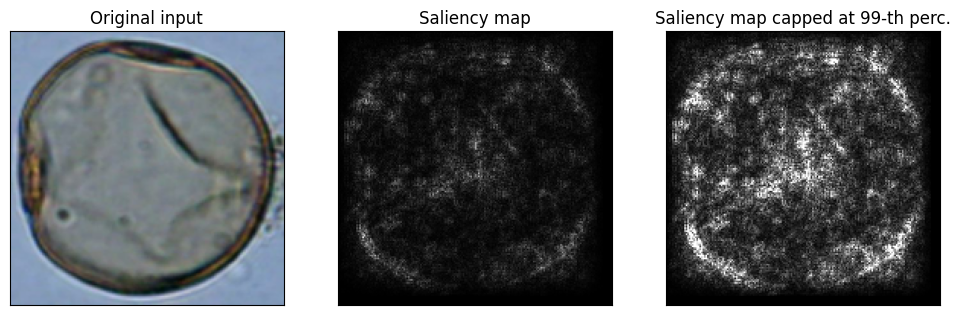

In [ ]:
representative_examples = sample_bylabel(train)
ex = representative_examples[22]
plot_example_sm(ex, model)

In [ ]:
def saliency_map_analysis(representative_examples: Dict[int, tf.Tensor],
                          model: tf.keras.Model) -> None:
    """
    Plots the original input image, its saliency map, and the saliency map capped at the 99th percentile
    for each example image in the given dictionary. The keys of the dictionary are the labels and the values
    are the corresponding sampled examples

    Parameters:
    - representative_examples Dict[int, tf.Tensor]: a dictionary of example images (one for each class)
    - model (tf.keras.Model): A TensorFlow neural network model.

    Returns:
    - None
    """

    fig, ax = plt.subplots(23, 5, figsize=(10,50), gridspec_kw={'wspace': 0, 'hspace': 0})
    ax = ax.flatten()

    for i, ex in enumerate(representative_examples.items()):

        img = ex[1]
        label = ex[0]
        idx1 = i * 5
        idx2 = i * 5 + 1
        idx3 = i * 5 + 2
        idx4 = i * 5 + 3
        idx5 = i * 5 + 4

        saliency_map = compute_saliency(img, model)
        capped_sm = capped_saliency(saliency_map)
        msm = modified_saliency(img, model)
        hist, bins = np.histogram(normalize_to_image(capped_sm), bins=256, range=(0,256))
        arr = hist
        ax[idx1].imshow(np.array(img, dtype=np.uint8))
        ax[idx1].set_xticks([])
        ax[idx1].set_ylabel(f'{labels[int(label)]}')
        ax[idx1].set_yticks([])
        ax[idx2].imshow(saliency_map, cmap="gray")
        ax[idx2].set_xticks([])
        ax[idx2].set_yticks([])
        ax[idx3].imshow(capped_sm, cmap="gray")
        ax[idx3].set_xticks([])
        ax[idx3].set_yticks([])
        ax[idx4].imshow(normalize_to_image(msm), cmap="gray")
        ax[idx4].set_xticks([])
        ax[idx4].set_yticks([])
        ax[idx5].plot(bins[:-1],arr, color='purple')
        ax[idx5].fill_between(x=bins[:-1], y1=arr, y2=np.repeat(np.min(arr), 256), color='purple', alpha=0.4)
        ax[idx5].axvline(np.median(hist), color='red', linestyle='dashed', linewidth=1)
        ax[idx5].set_xticks([])
        ax[idx5].set_yticks([])
        ax[idx5].spines['top'].set_visible(False)
        ax[idx5].spines['right'].set_visible(False)
        ax[idx5].spines['bottom'].set_visible(False)
        ax[idx5].spines['left'].set_visible(False)

        if i == 0:
          ax[idx1].set_title("Input")
          ax[idx2].set_title("Saliency Map")
          ax[idx3].set_title("Smooth S.M.")
          ax[idx4].set_title("Input X S.M.")
          ax[idx5].set_title("Saliency map \n pixels distr.")

    plt.show()

For a more "quantitative" comparative analysis I report the pixel distribution (in gray-scale) of the saliency maps. From these it is more evident that the extracted features in terms of skewness, median (vertical red line) and concentration around the median are quite discriminative between samples of different classes.

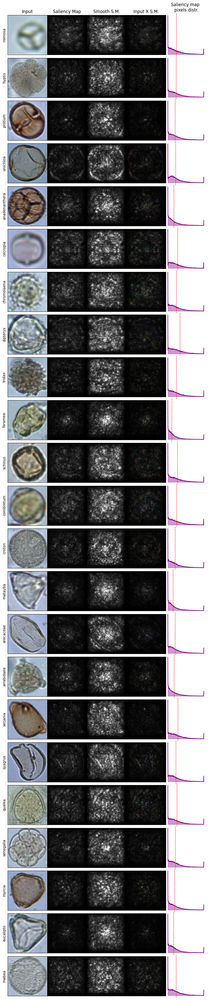

In [ ]:
saliency_map_analysis(representative_examples, model)

## Advanced saliency maps

> The reference in this section will be [2] for an overview on the limits of vanilla saliency maps and a description of SmoothGrad.

Saliency maps have several issues: most notably, they suffer from noise and they are not stable to small changes in the input or in the model (try running again the training and interpreting the same point). Many methods have been proposed to overcome this.

**[SmoothGrad](https://arxiv.org/abs/1706.03825)**, for example, computes multiple saliency maps from noisy versions of the input:

$$
  \text{SmoothGrad}(x) = \frac{1}{n}\sum_{i=1}^n S(x + \varepsilon_i), \;\; \varepsilon_i \sim \mathcal{N}(0, \sigma^2I)
$$

where $\varepsilon$ is a vector of the same shape as $x$, whose values are sampled from a normal distribution with zero mean and small variance.

Smoothed gradient is practically an usefull technique based on the injection of a certain amount of noise to the input image in order to paradoxally obtain sharper Saliency Maps.

In [ ]:
def noisy_saliency(input_: tf.Tensor,
                   model: tf.keras.Model,
                   sigma: int) -> np.ndarray:
    """
    Add noise to the given image, then compute the saliency map for the noisy
    (smoothed) image, considering the relative model's output.

    Parameters:
    - input_ (tf.Tensor): Input image.
    - model (tf.keras.Model): A TensorFlow neural network model.
    - sigma: the noise level to apply (integer between [0,+inf) which represents a percentage)

    Returns:
    - tf.Tensor: Modified saliency map.
    """

    input_ = tf.expand_dims(input_, axis=0)

    with tf.GradientTape() as gt:
        noise = tf.random.normal(input_.shape, mean=0, stddev=sigma)
        noisy_input = input_ + noise
        gt.watch(noisy_input)
        logit = model(noisy_input, training=False)
        logit = tf.squeeze(logit)
        class_score = logit[tf.argmax(logit)]

    saliency_map = gt.gradient(class_score, noisy_input)
    saliency_map = tf.squeeze(saliency_map)
    saliency_map = np.max(tf.abs(saliency_map), axis=-1)
    noisy_input = tf.squeeze(noisy_input)
    return saliency_map


def compute_smooth_saliency(input_: tf.Tensor,
                            model: tf.keras.Model,
                            n:int,
                            sigma: int) -> Tuple[np.ndarray, tf.Tensor]:
    """
    Add noise to the given image n times creting n randomly smoothed versions of the image.
    Then compute the smooth gradient using the n samples and their relative model's outputs.
    Return the smooth gradient result as a tensor (np.array type) and an example smoothed
    version of the original image just for visualization

    Parameters:
    - input_ (tf.Tensor): Input image.
    - model (tf.keras.Model): A TensorFlow neural network model.
    - sigma: the noise level to apply (integer between [0,+inf) which represents a percentage)
    - n: number of samples

    Returns:
    - tf.Tensor: Modified saliency map.
    """
    rep_tensor = tf.convert_to_tensor(tf.repeat(tf.expand_dims(input_, axis=0), n, 0))
    out = tf.map_fn(lambda x: noisy_saliency(x, model, sigma), rep_tensor)
    smooth_grad = np.mean(out, 0)
    noise = tf.random.normal(input_.shape, mean=0, stddev=sigma)
    noisy_inp = input_ + noise
    return smooth_grad, noisy_inp


In [ ]:
def plot_example_sg(ex: np.ndarray,
                    model: tf.keras.Model) -> None:
    """
    Plots the original input image, its saliency map, and the saliency map capped at the 99th percentile,
    an example of smoothed input and its corrispective

    Parameters:
    - ex (tf.Tensor): An example tensor representing an image.
    - model (tf.keras.Model): A TensorFlow neural network model.

    Returns:
    - None
    """

    saliency_map = compute_saliency(ex, model)
    smooth_saliency_map, noisy_ex = compute_smooth_saliency(ex, model, 10, 60)

    plt.rcdefaults()
    fig, ax = plt.subplots(1,6, figsize=(19,16))
    ax[0].imshow(np.array(ex, dtype=np.uint8))
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title("Original input")
    ax[1].imshow(saliency_map, cmap="gray")
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title("Saliency map")
    ax[2].imshow(capped_saliency(saliency_map), cmap="gray")
    ax[2].set_xticks([])
    ax[2].set_yticks([])
    ax[2].set_title("\"Capped\" saliency map")
    ax[3].imshow(normalize_to_image(noisy_ex))
    ax[3].set_xticks([])
    ax[3].set_yticks([])
    ax[3].set_title("Smoothed input")
    ax[4].imshow(smooth_saliency_map, cmap="gray")
    ax[4].set_xticks([])
    ax[4].set_yticks([])
    ax[4].set_title("Smoothed saliency map")
    ax[5].imshow(capped_saliency(smooth_saliency_map), cmap="gray")
    ax[5].set_xticks([])
    ax[5].set_yticks([])
    ax[5].set_title("\"Capped\" Smoothed map")
    plt.show()


def compare_noise_and_samples(ex: np.ndarray,
                              model: tf.keras.Model) -> None:
    """
    Plot the smooth gradient for different levels of noise and number of samples

    Parameters:
    - ex (tf.Tensor): An example tensor representing an image.
    - model (tf.keras.Model): A TensorFlow neural network model.

    Returns:
    - None
    """
    n_samples = np.arange(10, 81, 10)
    sigmas = np.arange(10, 150, 10)

    fig, ax = plt.subplots(len(n_samples), len(sigmas), figsize=(21,12), gridspec_kw={'wspace': 0, 'hspace': 0})
    ax = ax.flatten()

    for i, n in enumerate(n_samples):
      for j, s in enumerate(sigmas):
        idx =  i * len(sigmas) + j
        smooth_saliency_map, _ = compute_smooth_saliency(ex, model, s, n)
        ax[idx].imshow(smooth_saliency_map)
        ax[idx].set_xticks([])
        ax[idx].set_yticks([])
        if j == 0:
          ax[idx].set_ylabel(f'{n} samples')
        if i == 0:
          ax[idx].set_title(f'noise {s/255*100:.2f}%')

    plt.show()


def plot_sm_vs_sg(representative_examples: Dict[int, tf.Tensor],
                  model: tf.keras.Model,
                  n: int,
                  sigma: int) -> None:
    """
    Plots the original input image, its saliency map, and the saliency map capped at the 99th percentile,
    its smooth gradient and capped smooth gradient for given level of noise sigma and number of samples
    for each example image in the given dictionary. The keys of the dictionary are the labels and the values
    are the corresponding sampled examples

    Parameters:
    - representative_examples Dict[int, tf.Tensor]: a dictionary of example images (one for each class)
    - model (tf.keras.Model): A TensorFlow neural network model.
    - sigma: the noise level to apply (integer between [0,+inf) which represents a percentage)
    - n: number of samples

    Returns:
    - None
    """

    fig, ax = plt.subplots(23, 5, figsize=(10,50), gridspec_kw={'wspace': 0, 'hspace': 0})
    ax = ax.flatten()

    for i, ex in enumerate(representative_examples.items()):

        img = ex[1]
        label = ex[0]
        idx1 = i * 5
        idx2 = i * 5 + 1
        idx3 = i * 5 + 2
        idx4 = i * 5 + 3
        idx5 = i * 5 + 4

        saliency_map = compute_saliency(img, model)
        smooth_saliency, _ = compute_smooth_saliency(img, model, n, sigma)

        ax[idx1].imshow(np.array(img, dtype=np.uint8))
        ax[idx1].set_xticks([])
        ax[idx1].set_yticks([])
        ax[idx1].set_ylabel(f'{labels[int(label)]}')
        ax[idx2].imshow(saliency_map, cmap="gray")
        ax[idx2].set_xticks([])
        ax[idx2].set_yticks([])
        ax[idx3].imshow(capped_saliency(saliency_map), cmap="gray")
        ax[idx3].set_xticks([])
        ax[idx3].set_yticks([])
        ax[idx4].imshow(smooth_saliency, cmap="gray")
        ax[idx4].set_xticks([])
        ax[idx4].set_yticks([])
        ax[idx5].imshow(capped_saliency(smooth_saliency), cmap="gray")
        ax[idx5].set_xticks([])
        ax[idx5].set_yticks([])


        if i == 0:
          ax[idx1].set_title("Input")
          ax[idx2].set_title("Saliency Map")
          ax[idx3].set_title("Capped s.m.")
          ax[idx4].set_title("Smooth Gradient")
          ax[idx5].set_title("Capped s.g.")

    plt.show()

As we can see, the plots for the Smooth gradient are better in terms of interpretability and it'll be possible to better visualize the differences in the next plots with one example for each class.

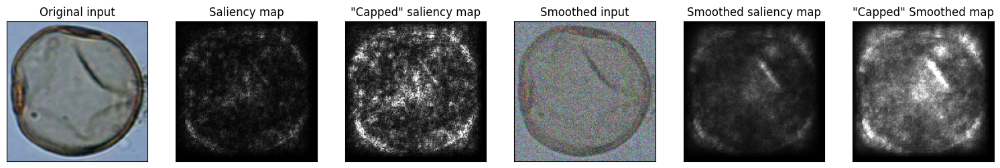

In [ ]:
plot_example_sg(ex, model)

Before reporting a complete comparison between the classic Saliency Maps and the outputs of the Smooth Gradients, I decided to report the Smooth Gradient for different levels of noise and number of samples. With a simple visualization (similarly to the source [2]) I selected the best combination of hyperparameters to use in my algorithm, and I opted for 40 samples and 50% of noise.

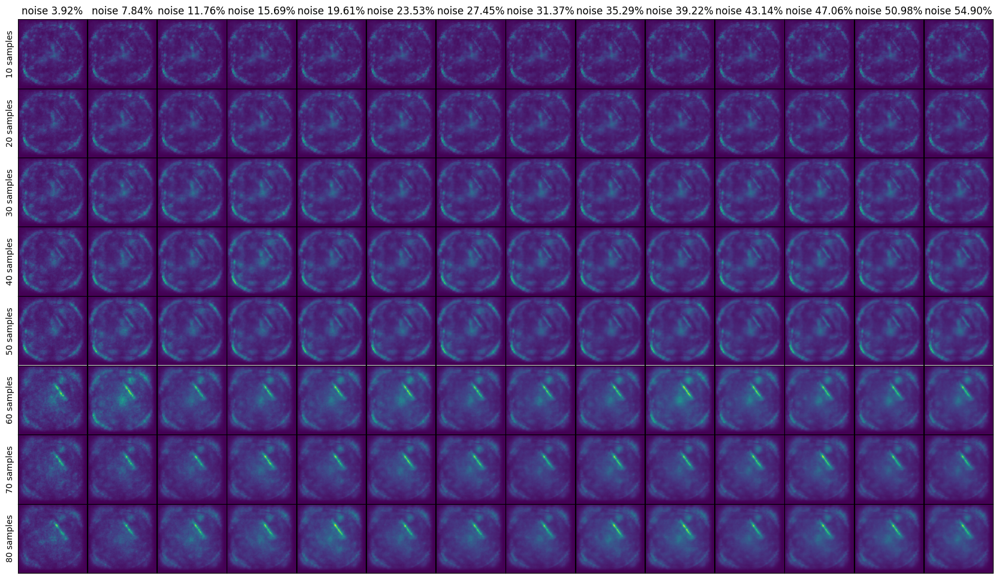

In [ ]:
compare_noise_and_samples(ex, model)

In general, the Smooth Gradient approach would seem to confirm the results obtained in the related paper and allows better visualization of Saliency Maps: note better discrimination between object and background and better defined edges.

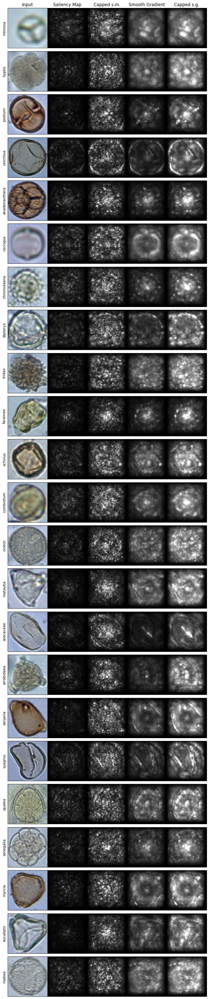

In [ ]:
plot_sm_vs_sg(representative_examples, model, 40, 50)

## Global explanations

The previous sections are examples of **local** explanations, where I tried to interpret a single prediction of the network. Sometimes we are interested in **global** explanations, that try to find common patterns of behaviour. Suppose we have a dataset $\mathcal{T} = \left\{x_i\right\}$ of examples, we can compute some approximate global measure of influence by averaging their saliency:

$$
\text{GlobalSaliency} = \frac{1}{n} \sum_i S(x_i)
$$

To make this exercise more interesting, we will split it into 3 parts.

I'll write a function to compute in parallel the saliency for multiple examples. Note that the resulting matrix $S$ will have shape $(n, d)$, where $n$ is the number of examples and $d$ the size of the input, which is the Jacobian of the network. I tried to write the function by avoiding for-loops and multiple tapes, using the [proper tools from TensorFlow](https://www.tensorflow.org/guide/advanced_autodiff).

In [ ]:
def parallel_saliency(dataset: tf.data.Dataset,
                      labels: Dict[int, str],
                      by_class: bool = False) -> Union[List[tf.Tensor], tf.Tensor]:
    """
    Compute the saliency map for each example in the training (or whatever) set.

    If by_class is set to True, the saliency maps are stacked in different tensors,
    divided by class, and then stored in a list. Otherwise, if by_class is set to
    False, every saliency map is stacked in a unique tensor.

    Parameters:
    - dataset (tf.data.Dataset): Input dataset containing examples.
    - labels (Dict[int, str]): Dictionary mapping class labels to their corresponding names.
    - by_class (bool): If True, stack saliency maps by class; if False, stack all maps together.

    Returns:
    - Union[List[tf.Tensor], tf.Tensor]: Stacked saliency maps, either as a list of tensors (if by_class=True)
      or as a single tensor (if by_class=False).
    """

    if by_class:
        stacked_smaps = []
        for i, l in labels.items():
            inputs = np.array([x[0] for x in dataset.unbatch().as_numpy_iterator() if x[1] == int(i)], dtype=np.float32)
            inputs = tf.convert_to_tensor(inputs)
            stacked_smaps.append(tf.map_fn(lambda x: compute_saliency(x, model), inputs))
    else:
        inputs = np.array([x[0] for x in train.unbatch().as_numpy_iterator()], dtype=np.float32)
        inputs = tf.convert_to_tensor(inputs)
        stacked_smaps = tf.map_fn(lambda x: compute_saliency(x, model), inputs)

    return stacked_smaps


# def model_jacobian(train, model):
#     inputs = np.array([x[0] for x in train.unbatch().as_numpy_iterator() if x[1]==int(i)], dtype=np.float32)
#     inputs = tf.convert_to_tensor(inputs)
#     with tf.GradientTape() as tape:
#       tape.watch(inputs)
#       preds = model(inputs)
#       class_scores = np.apply_along_axis(lambda x: x[tf.argmax(x)], axis=1, arr=preds)
#       class_scores.shape

#     dscore_dinput = tape.jacobian(class_scores, inputs)
#     return dscore_dinput

A function to compute the global saliency and try to explain the results.

In [ ]:
def global_saliency(dataset: tf.data.Dataset,
                    labels: Dict[int, str],
                    by_class: bool = False) -> Union[List[np.ndarray], np.ndarray]:
    """
    Compute the global saliency map for a dataset.

    Parameters:
    - dataset (tf.data.Dataset): Input dataset containing examples.
    - labels (Dict[int, str]): Dictionary mapping class labels to their corresponding names.
    - by_class (bool): If True, compute global saliency maps by class; if False, compute overall global saliency map.

    Returns:
    - Union[List[np.ndarray], np.ndarray]: Global saliency map(s), either as a list of numpy arrays (if by_class=True)
      or as a single numpy array (if by_class=False).
    """

    stacked_smaps = parallel_saliency(dataset, labels, by_class)

    if by_class:
        return [np.mean(i, axis=0) for i in stacked_smaps]

    return np.mean(stacked_smaps, axis=0)


In [ ]:
def show_global_sm(train: tf.data.Dataset,
                   labels: Dict[int, str]) -> np.ndarray:
    """
    Show global saliency maps for each class and overall dataset.

    Parameters:
    - train (tf.data.Dataset): Input training dataset containing examples.
    - labels (Dict[int, str]): Dictionary mapping class labels to their corresponding names.

    Returns:
    - np.ndarray: Overall global saliency map for the entire dataset.
    """

    fig, ax = plt.subplots(4, 6, figsize=(16, 12), gridspec_kw={'wspace': 0, 'hspace': 0})
    ax = ax.flatten()

    gs = global_saliency(train, labels, by_class=True)

    for i, saliency in enumerate(gs):
        ax[i].imshow(saliency)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(f'{labels[i]}')

    glob = global_saliency(train, labels)
    ax[-1].imshow(glob)
    ax[-1].set_title("All data set", color="red")
    ax[-1].set_xticks([])
    ax[-1].set_yticks([])

    plt.show()

    return glob

Global Salincy is a good technique for identifying informative features for image classification. In particular, I decided to report Global Saliency for both each image class and the whole daat set.

Interpretation of Global Saliencies is less intuitive than that of simple Saliency maps (in the case of a data set of images) because it is difficult to discern a well-defined figure during visualization. In fact, however, we can detect in these results a sort of "relevance distribution" of pixels of images of a certain class or of all images in the traing set. For certain classes the pixels representing the edges of the object are more or less always the same and are also noticeable in these plots (see for example the glob. sal. for the classes mabea and urochloa), while for most classes the central pixels are the most informative ones.


The global saliency with respect to the entire data set identifies as informative, in general, the central pixels (since most images present the subject of interest, i.e., the pollen grain, centered in the figure) and grant less attention to pixels in peripheral positions (the background fortunately is unique in all figures and cannot introduce any bias).

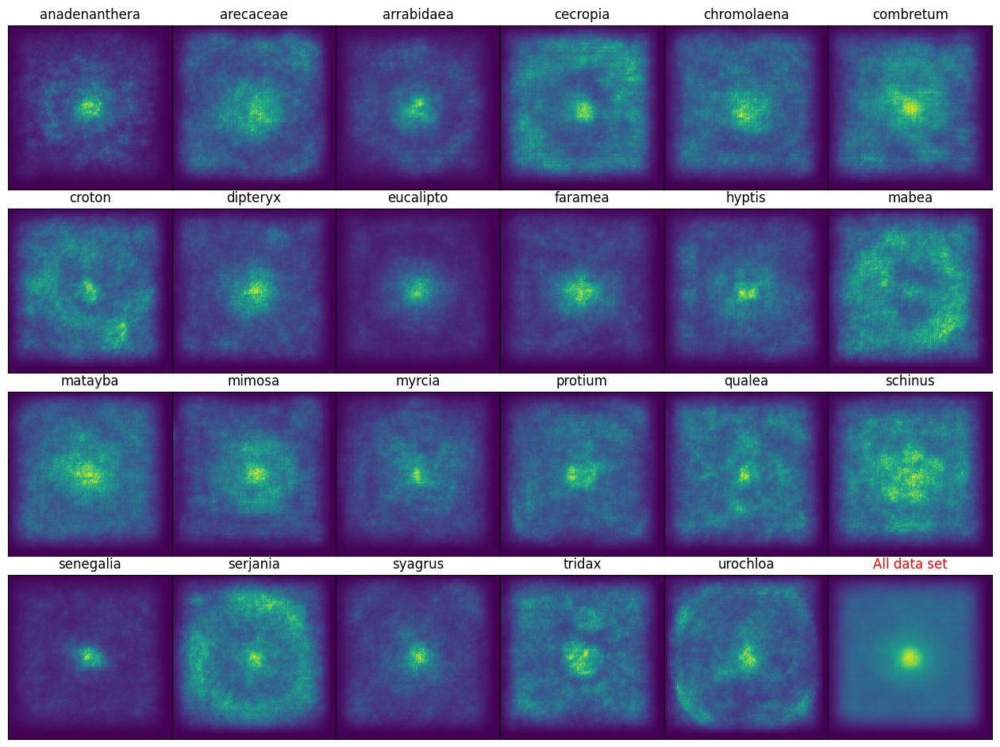

In [ ]:
glob = show_global_sm(train, labels)

Note that a linear model $f(x) = w^\top x + b$ is an example of an *intrinsically* interpretable  model, since the weights $w$ can be checked to analyze the global saliency of each feature (see [3]).

In [ ]:
linear_model = tf.keras.Sequential([
        layers.Flatten(input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)),
        layers.Dense(23)
    ])

EPOCHS = 100
BATCH_SIZE_SGD = 32

loss_func = losses.SparseCategoricalCrossentropy(from_logits=True)

linear_model.compile(optimizer='adam',
              loss=loss_func,
              metrics=['accuracy'])

history_lin = linear_model.fit(train, validation_data=val, epochs=EPOCHS, batch_size=BATCH_SIZE_SGD)

Epoch 1/100
40/40 [==============================] - 1s 9ms/step - loss: 38585.4102 - accuracy: 0.0491 - val_loss: 20027.5332 - val_accuracy: 0.0759
Epoch 2/100
40/40 [==============================] - 0s 5ms/step - loss: 12856.4170 - accuracy: 0.0886 - val_loss: 10162.9717 - val_accuracy: 0.1266
Epoch 3/100
40/40 [==============================] - 0s 5ms/step - loss: 9132.8076 - accuracy: 0.1519 - val_loss: 9211.0000 - val_accuracy: 0.1456
Epoch 4/100
40/40 [==============================] - 0s 6ms/step - loss: 6489.3687 - accuracy: 0.2184 - val_loss: 4571.7246 - val_accuracy: 0.1962
Epoch 5/100
40/40 [==============================] - 0s 6ms/step - loss: 4457.0142 - accuracy: 0.2595 - val_loss: 4978.3096 - val_accuracy: 0.2658
Epoch 6/100
40/40 [==============================] - 0s 5ms/step - loss: 3354.4133 - accuracy: 0.3212 - val_loss: 4552.8408 - val_accuracy: 0.2025
Epoch 7/100
40/40 [==============================] - 0s 5ms/step - loss: 3250.5305 - accuracy: 0.3370 - val_loss: 

To show the weights of a given linear model I'll follow the described procedure:

1. Take all the weights of the linear model (not biases), ending up with a matrix of dimension $N$x$C$ where $N$ is the input dimension and $C$ is the number of classes. For me the weights are represented by a tensor of dimension $(180*180*3)$ X $23$.

2. Take pixel-wise max (along the channel axis) for each of the 23 tensors and these 180 X 180 matrices will be plotted and represent the importance that the model gives to each pixel (independently from the color channel).

3. Also provide a global measure of importance taking the mean, along the class dimension, of the weights tensors and following the same above maximizing procedure for the plot.

In [ ]:
def show_weights_importance(weights: tf.Tensor,
                   labels: Dict[int, str]) -> np.ndarray:
    """
    Show the importance given by the linear model to each feature (pixel) of any
    training input (image). In this case plot the weghts for each neuron corresponding
    to a single class and also the mean of the weights w.r.t. all the classes.

    Parameters:
    - weights (tf.Tensor): The weights associated to a linear model (biases excluded)
    - labels (Dict[int, str]): Dictionary mapping class labels to their corresponding names.

    Returns:
    - None
    """
    weights = np.reshape(weights, (-1,180,180,3))

    fig, ax = plt.subplots(4, 6, figsize=(16, 12), gridspec_kw={'wspace': 0, 'hspace': 0})
    ax = ax.flatten()

    for i, w in enumerate(weights):

        importance = np.max(w, axis=-1)

        ax[i].imshow(normalize_to_image(importance))
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(f'{labels[i]}')

    glob_importance = np.max(np.mean(weights, axis=0), axis=2)
    ax[-1].imshow(normalize_to_image(glob_importance))
    ax[-1].set_title("All classes", color="red")
    ax[-1].set_xticks([])
    ax[-1].set_yticks([])

    plt.show()

There we can see that the weights distribution of the weights over the pixel deosn't show any kind of coherence. Indeed we cannot find any kind of structure/ visible pattern in the provided plots.

This is probably do to the lack of classification performance for the linear model: I had to use any single pixel for each channel as an individual feature, flattening each example to a really fat vector of dimension 180x180x3.
In this way the problem falls into the high dimensional case (number of features >> number of examples) and the simple linear model is not able to discriminate the images in different classes. The weights are poorly informative!

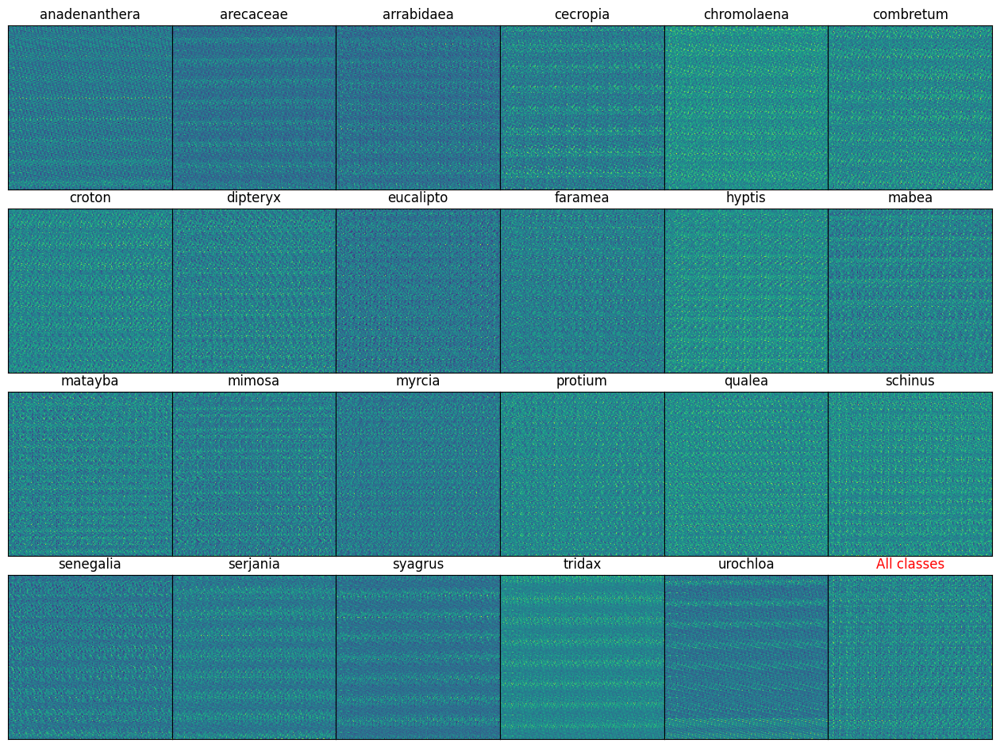

In [ ]:
# take the weights of the linear model
weights = linear_model.get_weights()[0]
# show the results
show_weights_importance(weights, labels)

## Integrated gradients



Formally, suppose we have a function $F : R^n → [0, 1]$ that
represents a deep network. Specifically, let $x ∈ R^n$ be the input at hand, and $x' ∈ R^n$ be the baseline input. For image
networks, the baseline could be the black image, while for
text models it could be the zero embedding vector.
Consider the straightline path (in $R^n$) from the baseline $x'$
to the input $x$, and compute the gradients at all points
along the path. __Integrated gradients__ are obtained by cumulating these gradients. Specifically, integrated gradients
are defined as the path intergral of the gradients along the
straightline path from the baseline $x'$ to the input $x$.
The **[Integrated Gradient](https://arxiv.org/abs/1703.01365)** along the i-th dimension for an input
$x$ and baseline $x'$ is defined as follows. Here, $\frac{\delta F (x)}{\delta x_i}$ is the gradient of $F(x)$ along the i-th dimension.

$$IntegratedGrads_i(x) = (x_i - x'_i) \times \int_{\alpha=0}^1 \frac{\delta F(x' + \alpha \times (x-x'))}{\delta x_i} d \alpha$$

I'm going to use obviously the approximated version given by the following fomrula:

$$ IntegratedGrads_i^*(x) = (x_i - x'_i) \times \sum_{k=1}^m \frac{\delta F(x' + \alpha \times (x-x'))}{\delta x_i} \times \frac{1}{m}$$


In [ ]:
def step_grad(input_: tf.Tensor,
              baseline: tf.Tensor,
              model: tf.keras.Model,
              k: int,
              m: int) -> np.ndarray:
    """
    Using the baseline image and the input image, compute the intermediate result
    for one step of the approximated Integrated Gradient algorithm.

    Parameters:
    - input_ (tf.Tensor): Input image.
    - baseline (tf.Tensor): Baseline image (with a saliency map of all 0s)
    - model (tf.keras.Model): A TensorFlow neural network model.
    - k (int): k-th iteration for the approximated integrated gradient algorithm
    - m (int): total number of iterations of the approximated integrated gradient algorithm

    Returns:
    - np.array: the intermediate result for one iteration of the algorithm.
    """

    input_ = tf.expand_dims(input_, axis=0)
    baseline = tf.expand_dims(baseline, axis=0)

    with tf.GradientTape() as gt:
        gt.watch(input_)
        num = baseline + tf.cast((k/m), dtype=input_.dtype) * tf.cast((input_ - baseline), dtype=tf.float32)
        logit = model(num, training=False)
        logit = tf.squeeze(logit)
        class_score = logit[tf.argmax(logit)]

    grad = gt.gradient(class_score, input_)
    grad = tf.squeeze(grad)
    return grad



def compute_integrated(input_: tf.Tensor,
                       baseline: tf.Tensor,
                       model: tf.keras.Model,
                       m: int) -> np.ndarray:
    """
    Call m times the 'step_grad' function. Return the result og the approximated
    Integrated Gradient algorihtm.

    Parameters:
    - input_ (tf.Tensor): Input image.
    - baseline (tf.Tensor): Baseline image (with a saliency map of all 0s)
    - model (tf.keras.Model): A TensorFlow neural network model.
    - m (int): total number of iterations of the approximated integrated gradient algorithm

    Returns:
    - np.array: the intermediate result for one iteration of the algorithm.
    """

    rep_tensor = tf.convert_to_tensor(np.arange(1,m+1,1), dtype=tf.float32)

    out = np.mean(tf.map_fn(lambda x: step_grad(input_, baseline, model, x, m), rep_tensor), 0)
    coeff = np.array(input_ - baseline)
    int_grad = coeff * out
    int_grad = np.max(tf.abs(int_grad), axis=-1)
    return int_grad

In [ ]:
def plot_sm_vs_ig(representative_examples: Dict[int, tf.Tensor],
                  baseline: tf.Tensor,
                  model: tf.keras.Model,
                  m: int,
                  n: int,
                  sigma: int) -> None:
    """
    Plots the original input image, its saliency map, and the saliency map capped at the 99th percentile,
    its smooth gradient and capped smooth gradient for given level of noise sigma and number of samples
    for each example image in the given dictionary. The keys of the dictionary are the labels and the values
    are the corresponding sampled examples

    Parameters:
    - representative_examples Dict[int, tf.Tensor]: a dictionary of example images (one for each class).
    - baseline (tf.Tensor): baseline example.
    - model (tf.keras.Model): A TensorFlow neural network model.
    - m (int): total number of iterations of the approximated integrated gradient algorithm
    - sigma: the noise level to apply (integer between [0,+inf) which represents a percentage).
    - n: number of samples

    Returns:
    - None
    """

    fig, ax = plt.subplots(23, 5, figsize=(10,50), gridspec_kw={'wspace': 0, 'hspace': 0})
    ax = ax.flatten()

    for i, ex in enumerate(representative_examples.items()):

        img = ex[1]
        label = ex[0]
        idx1 = i * 5
        idx2 = i * 5 + 1
        idx3 = i * 5 + 2
        idx4 = i * 5 + 3
        idx5 = i * 5 + 4

        smooth_saliency, _ = compute_smooth_saliency(img, model, n, sigma)
        integr_saliency = compute_integrated(img, baseline, model, m)

        ax[idx1].imshow(np.array(img, dtype=np.uint8))
        ax[idx1].set_xticks([])
        ax[idx1].set_yticks([])
        ax[idx1].set_ylabel(f'{labels[int(label)]}')
        ax[idx2].imshow(smooth_saliency, cmap="gray")
        ax[idx2].set_xticks([])
        ax[idx2].set_yticks([])
        ax[idx3].imshow(capped_saliency(smooth_saliency), cmap="gray")
        ax[idx3].set_xticks([])
        ax[idx3].set_yticks([])
        ax[idx4].imshow(integr_saliency, cmap="gray")
        ax[idx4].set_xticks([])
        ax[idx4].set_yticks([])
        ax[idx5].imshow(capped_saliency(integr_saliency), cmap="gray")
        ax[idx5].set_xticks([])
        ax[idx5].set_yticks([])


        if i == 0:
          ax[idx1].set_title("Input")
          ax[idx2].set_title("Smooth gradient")
          ax[idx3].set_title("Capped s.g.")
          ax[idx4].set_title("Integrated gradient")
          ax[idx5].set_title("Capped i.g.")

    plt.show()

As sugegsted in the paper [] I used the black image as baseline for the algorithm

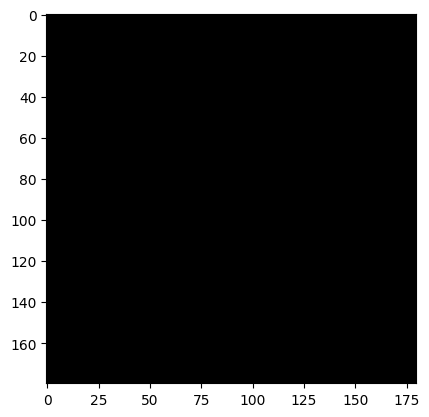

In [ ]:
baseline = tf.zeros((180, 180, 3), dtype=tf.float32)
plt.imshow(baseline)
plt.show()

I wanted to compare the Integrate gradient method with Smooth gradient previously proposed and the results seems to provide a way better representation and discrimination of important features!

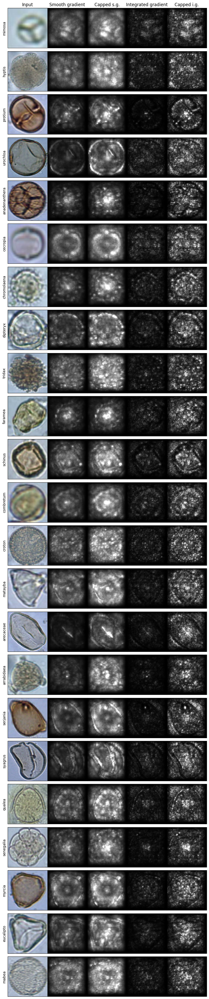

In [ ]:
plot_sm_vs_ig(representative_examples, baseline, model, m=20, n=40, sigma=50)

### Bibliography

[1] Simonyan, K., Vedaldi, A. and Zisserman, A., 2013. [Deep inside convolutional networks: Visualising image classification models and saliency maps](https://arxiv.org/abs/1312.6034). arXiv preprint arXiv:1312.6034.

[2] Smilkov, D., Thorat, N., Kim, B., Viégas, F. and Wattenberg, M., 2017. [SmoothGrad: removing noise by adding noise](https://arxiv.org/abs/1706.03825). arXiv preprint arXiv:1706.03825.

[3] Rudin, C., 2019. [Stop explaining black box machine learning models for high stakes decisions and use interpretable models instead](https://www.nature.com/articles/s42256-019-0048-x). Nature Machine Intelligence, 1(5), pp. 206-215.

[4] Nguyen, G., Kim, D. and Nguyen, A., 2021. [The effectiveness of feature attribution methods and its correlation with automatic evaluation scores](https://proceedings.neurips.cc/paper/2021/hash/de043a5e421240eb846da8effe472ff1-Abstract.html). Advances in Neural Information Processing Systems, 34, pp.26422-26436.

[5] Pruthi, G., Liu, F., Kale, S. and Sundararajan, M., 2020. [Estimating training data influence by tracing gradient descent](https://proceedings.neurips.cc/paper/2020/hash/e6385d39ec9394f2f3a354d9d2b88eec-Abstract.html). Advances in Neural Information Processing Systems, 33, pp. 19920-19930.